<a href="https://colab.research.google.com/github/jermwuyn/MachineLearning/blob/main/predict_stockprice_using_ARIMA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Finpros - Test 2 - Sử dụng model ARIMA để dự đoán biến động giá cổ phiếu

# Table of Contents
- [Libraries](#Libraries)
- [Choose Company](#Choose-company)
- [Load data](#Load-data)
- [Discover data](#Discover-data)
- [Preprocessing data](#Preprocessing-data)
- [Building model](#Building-model)
- [Evaluation and Testing](#Evaluation-and-Testing)
- [Predicting](#Predicting)
- [Testing on other companies stock](#Testing-on-other-companies-stock)

## Libraries

In [ ]:
import pandas as pd
import datetime as dt
import numpy as np
import seaborn as sns

import matplotlib.pyplot as plt
import plotly.graph_objs as go
from plotly.subplots import make_subplots as ms


from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.tsa.statespace.sarimax import SARIMAX
from pmdarima.arima import auto_arima


from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.preprocessing import MinMaxScaler

ModuleNotFoundError: ignored

[link text](https://)## Choose company

In [ ]:
company = "FPT"

## Load data

In [ ]:
df = pd.read_csv(f"{company}.csv")
df

,Ticker,Date/Time,Open,High,Low,Close,Volume,Open Interest
0,FPT,12/25/2018 9:15,30.89,30.89,30.89,30.89,35410,0
1,FPT,12/25/2018 9:16,30.81,30.81,30.81,30.81,190,0
2,FPT,12/25/2018 9:17,30.74,30.81,30.74,30.74,1120,0
3,FPT,12/25/2018 9:18,30.74,30.74,30.74,30.74,2120,0
4,FPT,12/25/2018 9:19,30.74,30.74,30.74,30.74,22500,0
...,...,...,...,...,...,...,...,...
97401,FPT,12/22/2020 14:24,58.20,58.20,58.20,58.20,27470,0
97402,FPT,12/22/2020 14:25,58.20,58.20,58.20,58.20,14820,0
97403,FPT,12/22/2020 14:26,58.20,58.20,58.20,58.20,500,0
97404,FPT,12/22/2020 14:29,58.10,58.10,58.10,58.10,2500,0


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 97406 entries, 0 to 97405
Data columns (total 8 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Ticker         97406 non-null  object 
 1   Date/Time      97406 non-null  object 
 2   Open           97406 non-null  float64
 3   High           97406 non-null  float64
 4   Low            97406 non-null  float64
 5   Close          97406 non-null  float64
 6   Volume         97406 non-null  int64  
 7   Open Interest  97406 non-null  int64  
dtypes: float64(4), int64(2), object(2)
memory usage: 5.9+ MB


In [ ]:
df.describe()

,Open,High,Low,Close,Volume,Open Interest
count,97406.000000,97406.000000,97406.000000,97406.000000,9.740600e+04,97406.0
mean,45.071630,45.090138,45.051430,45.071631,8.044173e+03,0.0
std,6.359803,6.364950,6.354245,6.359799,1.753203e+04,0.0
min,30.250000,30.250000,30.220000,30.250000,1.000000e+01,0.0
25%,39.740000,39.740000,39.700000,39.740000,7.500000e+02,0.0
50%,46.950000,46.950000,46.950000,46.950000,2.960000e+03,0.0
75%,49.200000,49.250000,49.170000,49.200000,8.960000e+03,0.0
max,58.400000,58.500000,58.400000,58.400000,1.255930e+06,0.0


## Discover data

In [ ]:
#Kiểm tra Stationarity bằng ADF_Test
def ADF_Test(data):
    result = adfuller(data)
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    if result[0] < result[4]['5%']:
        print('Data is stationary')
    else:
        print('Data is non-stationary')

ADF_Test(df['Close'])

ADF Statistic: -1.345307
p-value: 0.608198
Critical Values:
	1%: -3.430
	5%: -2.862
	10%: -2.567
Data is non-stationary


In [ ]:
#Kiểm tra tính season
df['Date/Time'] = pd.to_datetime(df['Date/Time'])
df2 = df.set_index('Date/Time').sort_index()
result = seasonal_decompose(df2['Close'], model='multiplicative', period=10000)
data = {'Trend': result.trend, 'Seasonal': result.seasonal, 'Residual': result.resid}
result_df = pd.DataFrame(data)
print(result_df)
result_df.describe()

                     Trend  Seasonal  Residual
Date/Time                                     
2018-12-25 09:15:00    NaN  1.005632       NaN
2018-12-25 09:16:00    NaN  1.006898       NaN
2018-12-25 09:17:00    NaN  1.007104       NaN
2018-12-25 09:18:00    NaN  1.006440       NaN
2018-12-25 09:19:00    NaN  1.006808       NaN
...                    ...       ...       ...
2020-12-22 14:24:00    NaN  0.991108       NaN
2020-12-22 14:25:00    NaN  0.990781       NaN
2020-12-22 14:26:00    NaN  0.991093       NaN
2020-12-22 14:29:00    NaN  0.991270       NaN
2020-12-22 14:46:00    NaN  0.991223       NaN

[97406 rows x 3 columns]


,Trend,Seasonal,Residual
count,87406.000000,97406.000000,87406.000000
mean,45.193233,1.000231,0.999538
std,5.011176,0.009388,0.031442
min,33.209713,0.974519,0.824767
25%,42.023890,0.995015,0.983865
50%,47.041364,0.998539,0.997946
75%,48.759213,1.006155,1.019886
max,54.596325,1.023863,1.095461


In [ ]:
#Vẽ biểu đồ
fig = ms(rows=4, cols=1, shared_xaxes=True)
#Close
fig.add_trace(go.Scatter(x=df2.index, y=df2['Close'], name=f'Giá đóng cửa cổ phiếu {company}'),row=1, col=1)
#Trend
fig.add_trace(go.Scatter(x=df2.index, y=result.trend, name='Trend'),row=2, col=1)
#Seasonality
fig.add_trace(go.Scatter(x=df2.index, y=result.seasonal, name='Seasonality'),row=3, col=1)
#Residual
fig.add_trace(go.Scatter(x=df2.index, y=result.resid, name='Residual'),row=4, col=1)
fig.update_layout(height=700, width=1000, title_text="Quan sát các tính chất Time-Series")
fig.show()


Số lượng outlier: 0


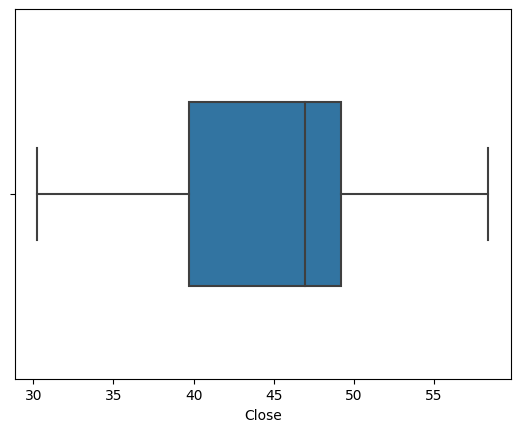

Số lượng outlier: 8606


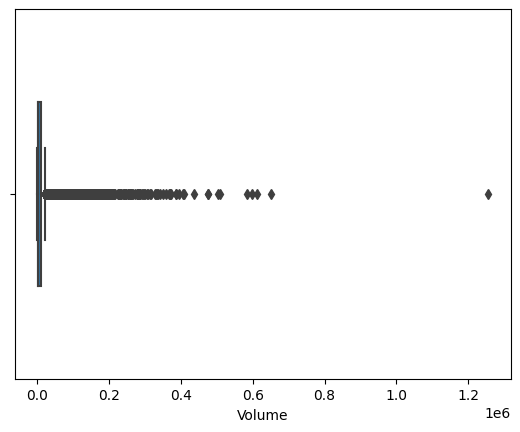

In [ ]:
#Kiểm tra outliers
def check_outliers(data):
    Q1 = np.percentile(data, 25)
    Q3 = np.percentile(data, 75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    outliers = data[(data < lower_bound) | (data > upper_bound)]
    print(f"Số lượng outlier: {len(outliers)}")

    sns.boxplot(x=data, whis=1.5, width=0.5)
    plt.show()

check_outliers(df['Close'])
check_outliers(df['Volume'])

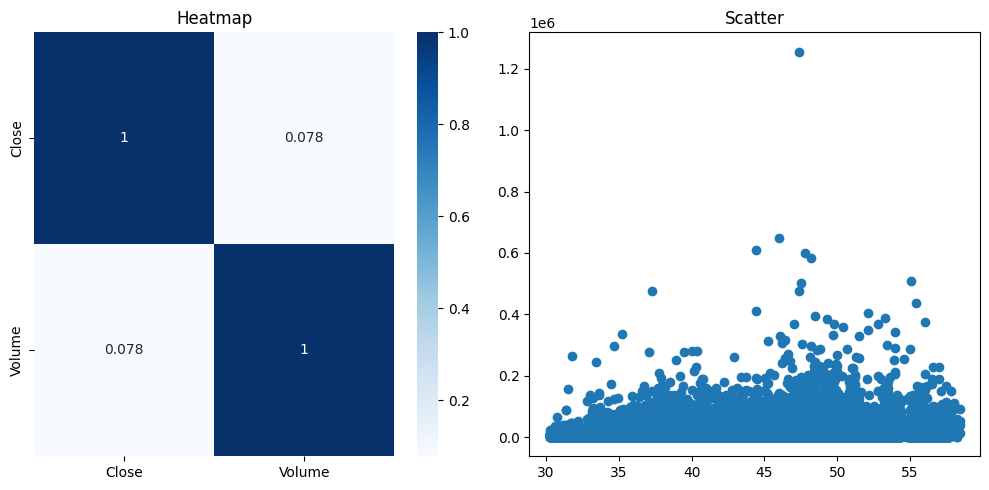

In [ ]:
#Không cần phải loại bỏ outlier trong trường hợp này
#Kiểm tra mối tương quan giữa Close và Volume
fig, axs = plt.subplots(1, 2, figsize=(10, 5))

heatmap = sns.heatmap(df[['Close', 'Volume']].corr(), annot=True, cmap='Blues', ax=axs[0])
axs[0].set_title("Heatmap")

scatter = axs[1].scatter(df['Close'], df['Volume'])
axs[1].set_title("Scatter")

fig.tight_layout()
plt.savefig('figure.png')

## Preprocessing data

In [ ]:
df['Date/Time'] = pd.to_datetime(df['Date/Time'])
df = df[['Date/Time', 'Close', 'Volume']]
df = df.set_index('Date/Time').sort_index()
df = df.resample('H').agg({'Close': 'first', 'Volume': 'sum'})
df = df.fillna(method='ffill')
df['PriceDiff'] = df['Close'].diff()
df['VolumeDiff'] = df['Volume'].diff()
df = df[['PriceDiff','VolumeDiff']]
df.dropna(inplace=True)
df

,PriceDiff,VolumeDiff
Date/Time,,
2018-12-25 10:00:00,0.0,-84960.0
2018-12-25 11:00:00,0.0,0.0
2018-12-25 12:00:00,0.0,0.0
2018-12-25 13:00:00,0.0,0.0
2018-12-25 14:00:00,0.0,0.0
...,...,...
2020-12-22 10:00:00,0.0,17770.0
2020-12-22 11:00:00,0.1,1410.0
2020-12-22 12:00:00,0.0,-359420.0


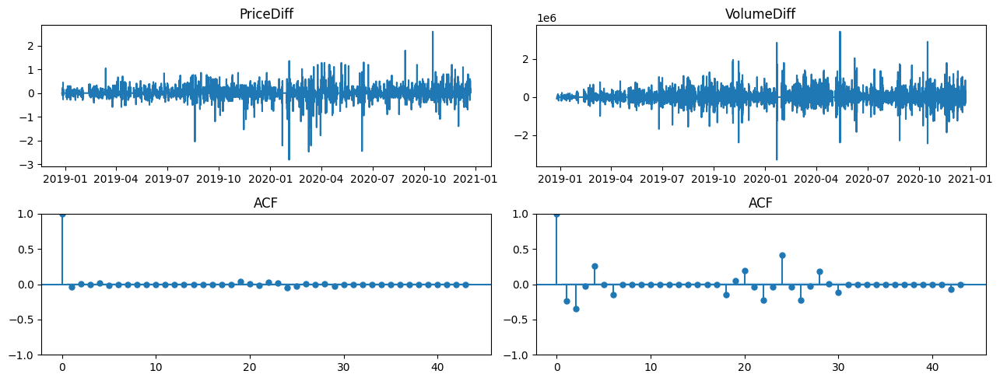

In [ ]:
#Kiểm tra lại stationary của biến Diff
fig, axs = plt.subplots(2, 2, figsize=(13, 5))
axs[0, 0].plot(df['PriceDiff'])
axs[0, 0].set_title('PriceDiff')
axs[0, 1].plot(df['VolumeDiff'])
axs[0, 1].set_title('VolumeDiff')
plot_acf(df['PriceDiff'], ax=axs[1, 0])
plot_acf(df['VolumeDiff'], ax=axs[1, 1])
axs[1, 0].set_title('ACF')
axs[1, 1].set_title('ACF')
fig.tight_layout()
plt.show()

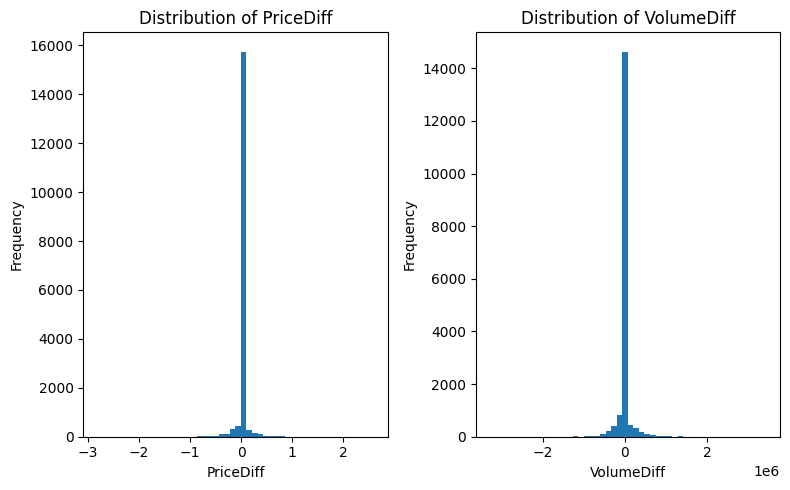

In [ ]:
#Kiểm tra pp chuẩn
fig, axs = plt.subplots(1,2, figsize=(8, 5))
axs[0].hist(df['PriceDiff'], bins=50)
axs[0].set_xlabel('PriceDiff')
axs[0].set_ylabel('Frequency')
axs[0].set_title('Distribution of PriceDiff')
axs[1].hist(df['VolumeDiff'], bins=50)
axs[1].set_xlabel('VolumeDiff')
axs[1].set_ylabel('Frequency')
axs[1].set_title('Distribution of VolumeDiff')
plt.tight_layout()
plt.show()

## Building model

In [ ]:
train_size = int(len(df) * 0.8)
train, test = df.iloc[:train_size], df.iloc[train_size:]

#Phân phối có hình dạng bất thường => MinMaxScale tránh rủi ro
scaler = MinMaxScaler()
train_scaled = scaler.fit_transform(train)
test_scaled = scaler.transform(test)

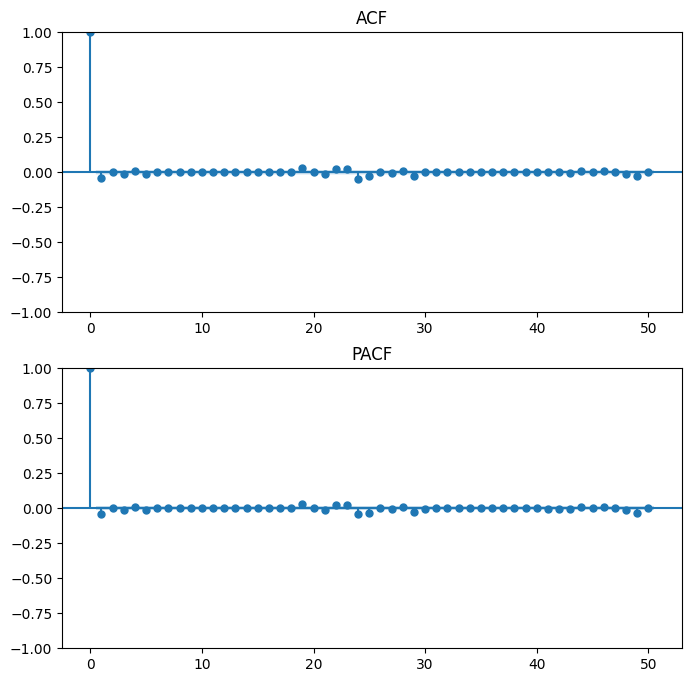

In [ ]:
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(8, 8))
plot_acf(df['PriceDiff'], lags=50, ax=ax1, title = 'ACF')
plot_pacf(df['PriceDiff'], lags=50, ax=ax2, title = 'PACF', method = 'ywm')
plt.show()

In [ ]:
#Theo ACF, PACF => Sử dụng (1,0,0) hoặc (1,0,1). d = none do đã differencing 1 lần và quan sát không thấy cần thêm differencing. m =24 1day
#Sử dụng thuật toán auto_arima để tìm tổ hợp pdq với AIC và log Likelihood tốt nhất
stepwise_model = auto_arima(train_scaled[:, 0], exogenous=train_scaled[:, 1],
                            start_p=0, start_q=0, max_p=24, max_q=24, seasonal=True,
                            d=None, D=None, trace=True,
                            suppress_warnings=True, stepwise=True)
stepwise_model.summary()


Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=-60351.731, Time=0.65 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=-60366.343, Time=0.32 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=-60366.053, Time=2.73 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=28706.698, Time=0.21 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=-60365.285, Time=0.82 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=-60364.276, Time=0.53 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=-60363.282, Time=0.60 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=0.38 sec

Best model:  ARIMA(1,0,0)(0,0,0)[0] intercept
Total fit time: 6.257 seconds


<class 'statsmodels.iolib.summary.Summary'>
"""
                               SARIMAX Results                                
==============================================================================
Dep. Variable:                      y   No. Observations:                13981
Model:               SARIMAX(1, 0, 0)   Log Likelihood               30186.171
Date:                Sun, 09 Apr 2023   AIC                         -60366.343
Time:                        17:34:51   BIC                         -60343.706
Sample:                             0   HQIC                        -60358.806
                              - 13981                                         
Covariance Type:                  opg                                         
==============================================================================
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
intercept      0.6981      0.002    340.389      0.000       0.694       0.702
ar.L1         -0.0345      0.003    -11.535      0.000      -0.040      -0.029
sigma2         0.0008   1.28e-06    607.375      0.000       0.001       0.001
===================================================================================
Ljung-Box (L1) (Q):                   0.00   Jarque-Bera (JB):           7750067.49
Prob(Q):                              0.97   Prob(JB):                         0.00
Heteroskedasticity (H):               5.82   Skew:                            -3.30
Prob(H) (two-sided):                  0.00   Kurtosis:                       118.15
===================================================================================

Warnings:
[1] Covariance matrix calculated using the outer product of gradients (complex-step).
"""

In [ ]:
model = SARIMAX(train_scaled[:, 0], exog=train_scaled[:, 1], order=(1,0,0), seasonal_order=(0,0,0,0))
model_fit = model.fit()

## Evaluation and testing

In [ ]:
predict_train = model_fit.predict(start=0, end=len(train_scaled)-1, exog=train_scaled[:, 1])
predict_test = model_fit.forecast(steps=len(test_scaled), exog=test_scaled[:, 1])

predict_train = scaler.inverse_transform(np.concatenate((predict_train.reshape(-1, 1), train_scaled[:, 1].reshape(-1, 1)), axis=1))
predict_test = scaler.inverse_transform(np.concatenate((predict_test.reshape(-1, 1), test_scaled[:, 1].reshape(-1, 1)), axis=1))

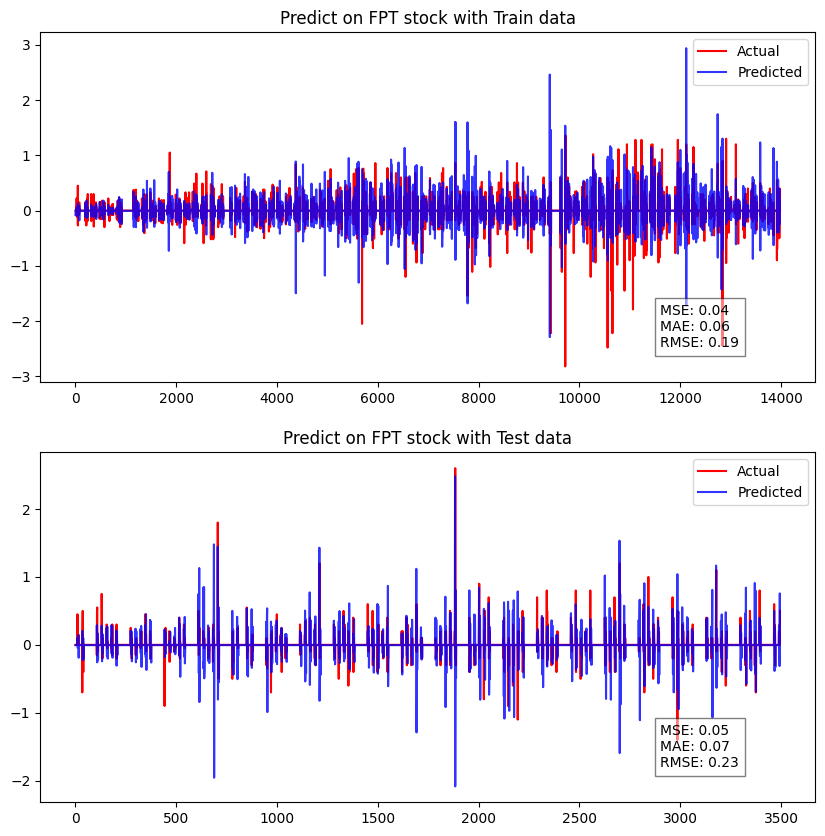

In [ ]:
fig, axs = plt.subplots(2,1, figsize=(10, 10))
axs[0].plot(scaler.inverse_transform(train_scaled)[:, 0], label='Actual',color='red')
axs[0].plot(predict_train[:, 0], label='Predicted',color='blue',alpha=0.8)
axs[0].set_title(f'Predict on {company} stock with Train data')
axs[0].legend()
axs[1].plot(scaler.inverse_transform(test_scaled)[:, 0], label='Actual',color='red')
axs[1].plot(predict_test[:, 0], label='Predicted',color='blue',alpha=0.8)
axs[1].set_title(f'Predict on {company} stock with Test data')
axs[1].legend()

mse_train = mean_squared_error(train['PriceDiff'], predict_train[:, 0])
mae_train = mean_absolute_error(train['PriceDiff'], predict_train[:, 0])
rmse_train = np.sqrt(mean_squared_error(train['PriceDiff'], predict_train[:, 0]))
mse_test = mean_squared_error(test['PriceDiff'], predict_test[:, 0])
mae_test = mean_absolute_error(test['PriceDiff'], predict_test[:, 0])
rmse_test = np.sqrt(mean_squared_error(test['PriceDiff'], predict_test[:, 0]))

axs[0].text(0.8, 0.1, f'MSE: {mse_train:.2f}\nMAE: {mae_train:.2f}\nRMSE: {rmse_train:.2f}', transform=axs[0].transAxes, bbox=dict(facecolor='white', alpha=0.5))
axs[1].text(0.8, 0.1, f'MSE: {mse_test:.2f}\nMAE: {mae_test:.2f}\nRMSE: {rmse_test:.2f}', transform=axs[1].transAxes, bbox=dict(facecolor='white', alpha=0.5))
plt.show()

## Predicting

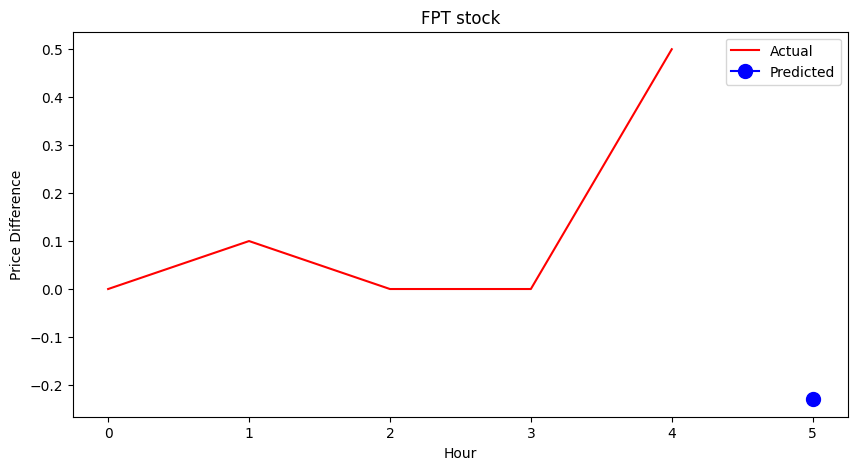

In [ ]:
next_price_diff = model_fit.forecast(steps=1, exog=test_scaled[-1, 1].reshape(1, -1))
next_price_diff = scaler.inverse_transform(np.concatenate((next_price_diff.reshape(-1, 1), test_scaled[-1, 1].reshape(-1, 1)), axis=1))

actual_data = scaler.inverse_transform(test_scaled)[-5:, 0]
predicted_data = np.concatenate((actual_data[:-1], next_price_diff[:, 0]))

plt.figure(figsize=(10,5))
plt.plot(range(5),actual_data, color='red', label='Actual')
plt.plot(5, predicted_data[-1], marker='o', markersize=10, color='blue', label='Predicted')
plt.legend()
plt.title(f'{company} stock')
plt.xlabel('Hour')
plt.ylabel('Price Difference')
plt.show()

## Testing on other companies stock

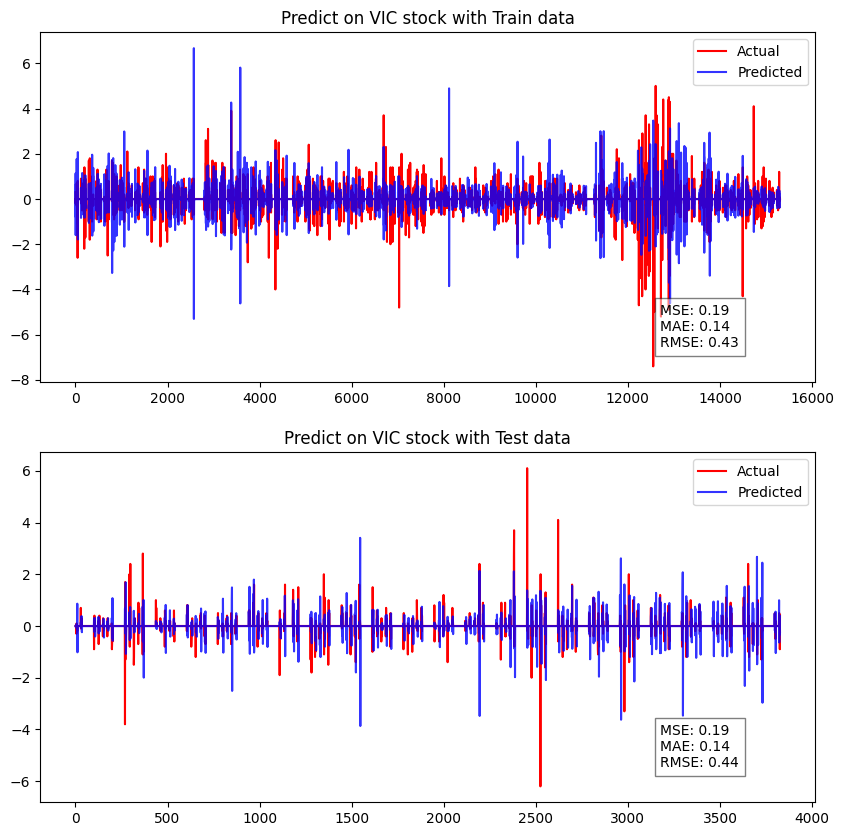

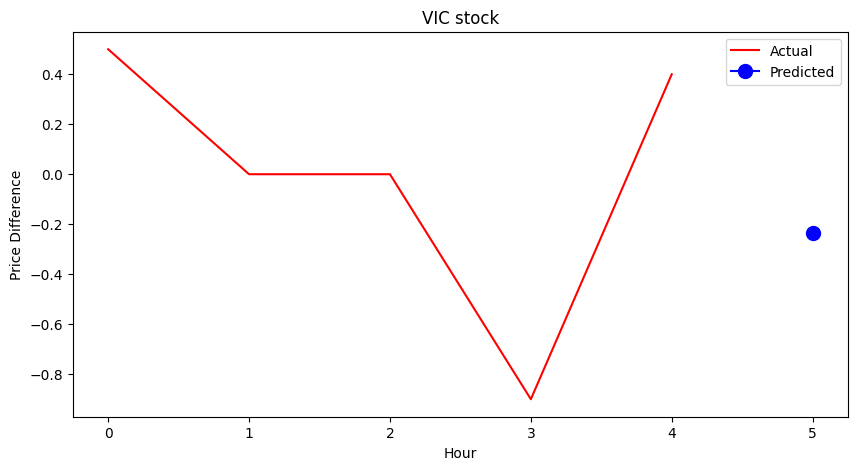

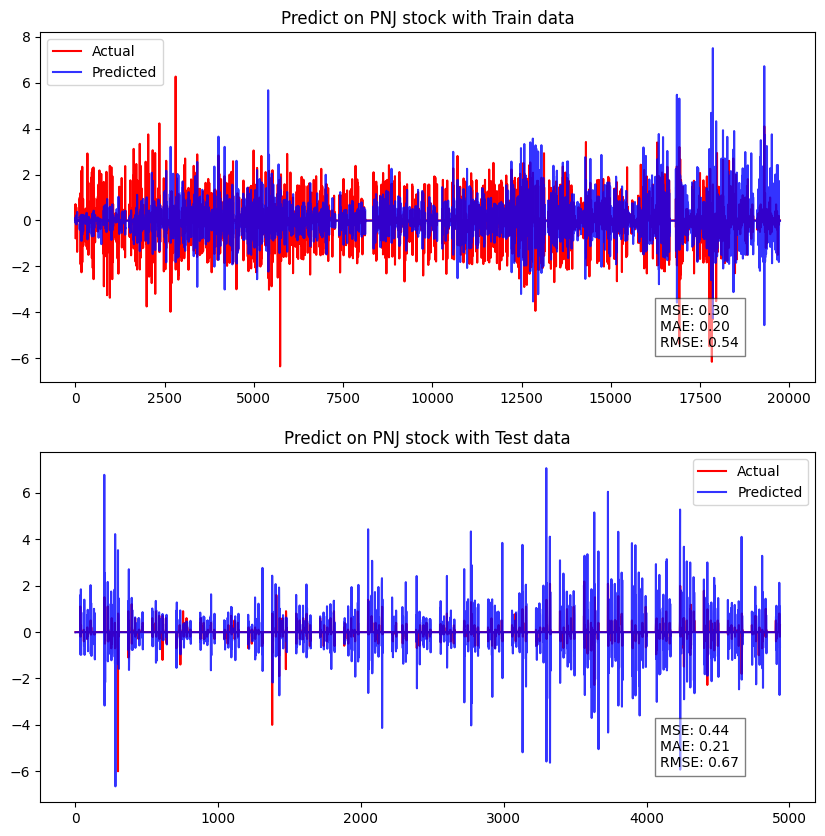

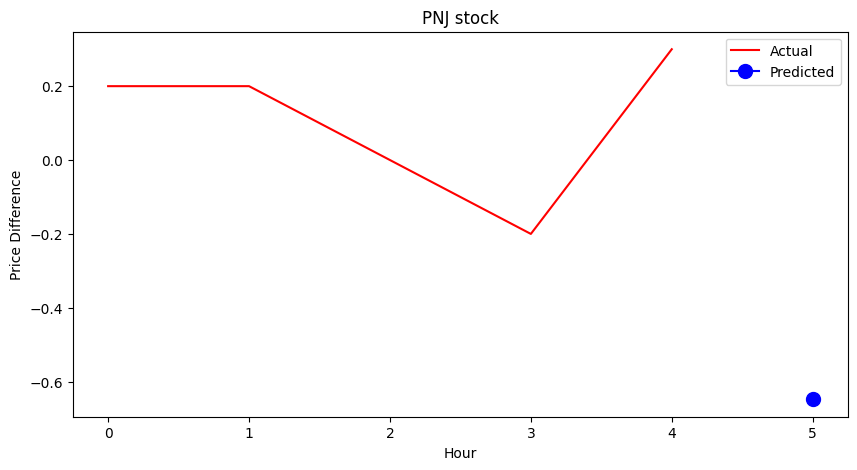

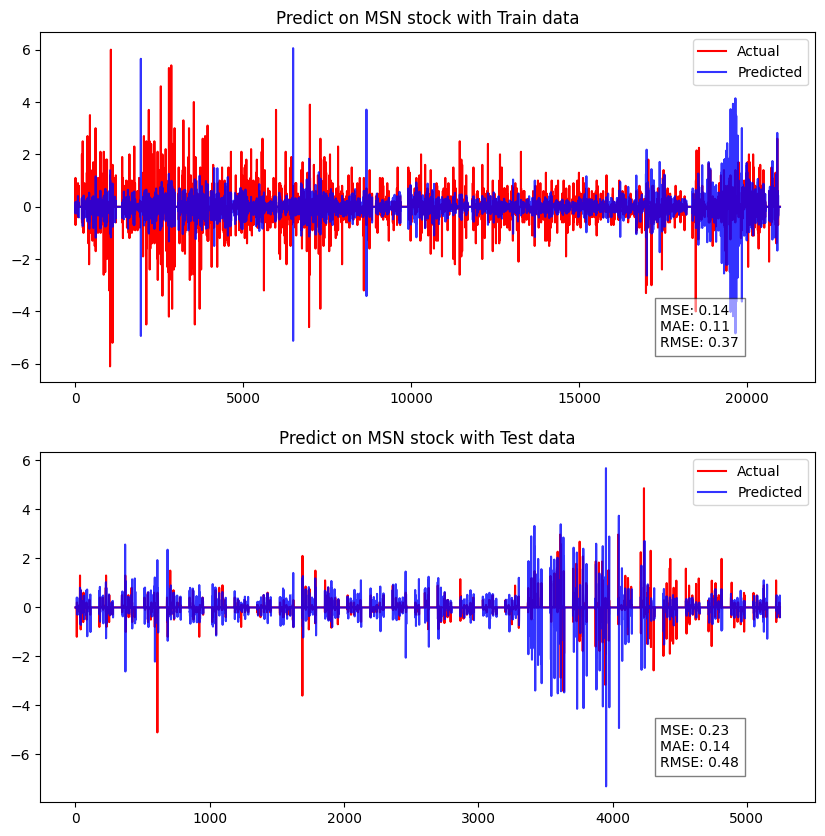

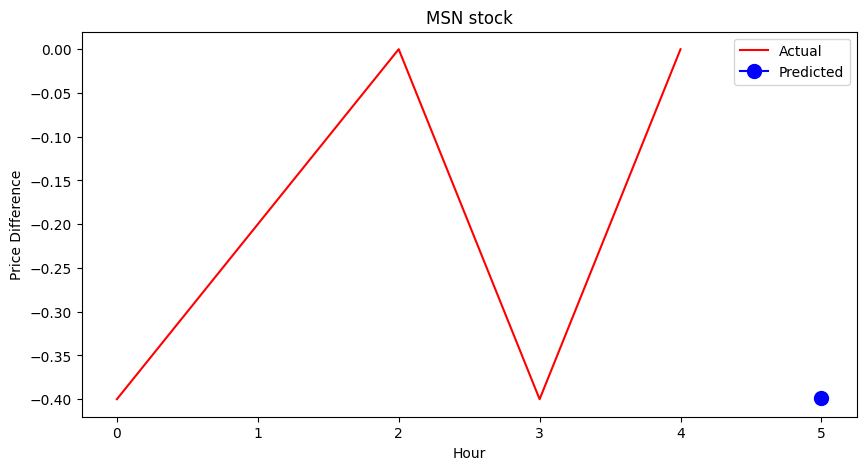